### Подтягиваем веса модели

In [1]:
import sys
from pathlib import Path
sys.path.append(str(Path.cwd().parent))

from diffusers import StableDiffusionXLPipeline
import torch

/home/igmamedov/.venv/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
/home/igmamedov/.venv/lib/python3.10/site-packages/xformers/ops/fmha/flash.py:211: FutureWarning: `torch.library.impl_abstract` was renamed to `torch.library.register_fake`. Please use that instead; we will remove `torch.library.impl_abstract` in a future version of PyTorch.
  @torch.library.impl_abstract("xformers_flash::flash_fwd")
/home/igmamedov/.venv/lib/python3.10/site-packages/xformers/ops/fmha/flash.py:344: FutureWarning: `torch.library.impl_abstract` was renamed to `torch.library.register_fake`. Please use that instead; we will remove `torch.library.impl_abstract` in a future version of PyTorch.
  @torch.library.impl_abstract("xformers_flash::flash_bwd")


In [2]:
# Базовая модель
model_id = "stabilityai/stable-diffusion-xl-base-1.0"

# Загружаем модель
pipe = StableDiffusionXLPipeline.from_pretrained(model_id, torch_dtype=torch.float16)
pipe = pipe.to("cuda")

# Подключаем LoRA
pipe.load_lora_weights(f"pytorch_lora_weights.safetensors", weight=1.0)

Loading pipeline components...: 100%|██████████| 7/7 [00:17<00:00,  2.46s/it]
No LoRA keys associated to CLIPTextModel found with the prefix='text_encoder'. This is safe to ignore if LoRA state dict didn't originally have any CLIPTextModel related params. You can also try specifying `prefix=None` to resolve the warning. Otherwise, open an issue if you think it's unexpected: https://github.com/huggingface/diffusers/issues/new
No LoRA keys associated to CLIPTextModelWithProjection found with the prefix='text_encoder_2'. This is safe to ignore if LoRA state dict didn't originally have any CLIPTextModelWithProjection related params. You can also try specifying `prefix=None` to resolve the warning. Otherwise, open an issue if you think it's unexpected: https://github.com/huggingface/diffusers/issues/new


### Генерируем семпл

In [3]:
from data.test_prompts import live_set, object_set, base_prompt

In [4]:
for i in range(5):
    generator = torch.manual_seed(i)
    image = pipe(
        base_prompt, 
        num_inference_steps=30, 
        guidance_scale=7.5, 
        generator=generator
    ).images[0]
    image.save(f"sample/base_prompt_{i}.png")

100%|██████████| 30/30 [00:08<00:00,  3.43it/s]


In [5]:
index = [1, 10, 15]
sets = [live_set, object_set]

for i, s in enumerate(sets):
    for idx in index:
        for seed in range(5):
            prompt = s[idx]
            generator = torch.manual_seed(i+idx+seed)
            image = pipe(
                prompt, 
                num_inference_steps=30, 
                guidance_scale=7.5, 
                generator=generator
            ).images[0]
            image.save(f"sample/set_{i}_prompt_{idx}_{seed}.png")

100%|██████████| 30/30 [00:08<00:00,  3.42it/s]


### Считаем метрики

https://arxiv.org/pdf/2208.01618

In [6]:
from src.metrics import reconstruction_score, editability_score
from glob import glob

In [7]:
gen_base_files = glob("sample/base_prompt_*.png", recursive=True)
real_files = glob("../dataset/few_shot/instance_images/*", recursive=True)

In [8]:
# reconstruction_score
reconstruction_score(gen_base_files, real_files)

0.79248046875

In [9]:
# editability_score
all_scores = []
for i, s in enumerate(sets):
    for idx in index:
        for seed in range(5):
            prompt = s[idx]
            prompt = prompt.replace("sks", "")
            files = glob(f"sample/set_{i}_prompt_{idx}_*.png", recursive=True)
            score = editability_score(files, prompt)
            all_scores.append(score)

In [10]:
sum(all_scores) / len(all_scores)

0.3513590494791667

### Пример генерации

In [11]:
from utils.visual import make_grid_with_caption
from PIL import Image

### Базовое изображение

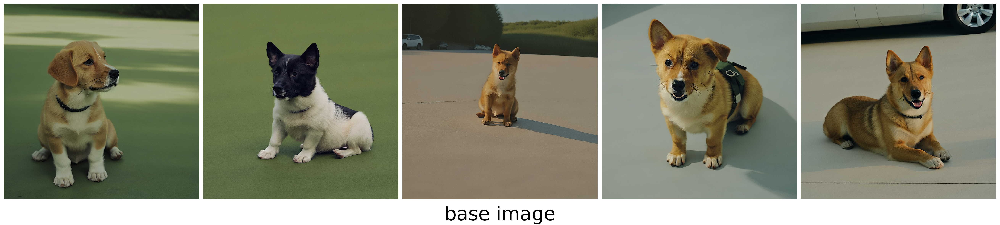

In [12]:
files = glob(f"sample/base_prompt_*.png", recursive=True)
images = [Image.open(f).convert("RGB") for f in files]
text = "base image"
    
make_grid_with_caption(images, text)

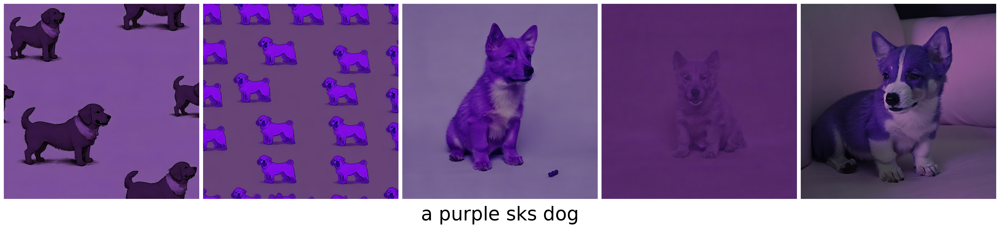

In [13]:
s = 0
idx = 1 

prompt = sets[s][idx]
files = glob(f"sample/set_{s}_prompt_{idx}_*.png", recursive=True)
images = [Image.open(f).convert("RGB") for f in files]
    
make_grid_with_caption(images, prompt)

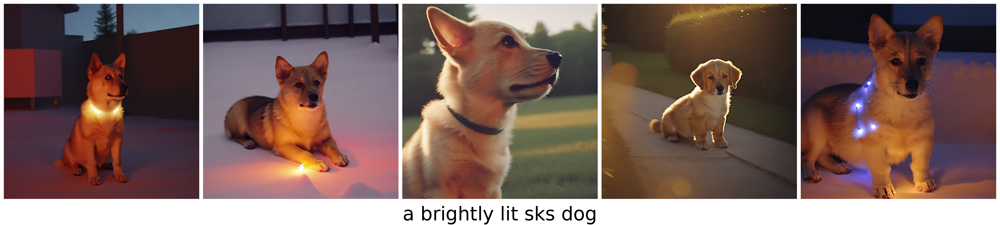

In [14]:
s = 1
idx = 1 

prompt = sets[s][idx]
files = glob(f"sample/set_{s}_prompt_{idx}_*.png", recursive=True)
images = [Image.open(f).convert("RGB") for f in files]
    
make_grid_with_caption(images, prompt)

___